# List 7

## Beta-binomial model


### Knowledge & Skills:
- likelihood
- apriori
- aposteriori
- maximum likelihood estimate
- maximum aposteriori estimate
- online (sequential) and batch learnig
- [Book for help](https://github.com/jonesgithub/book-1/blob/master/ML%20Machine%20Learning-A%20Probabilistic%20Perspective.pdf)

In [1]:
import scipy as sp
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.animation as anim
from scipy.stats import binom
from scipy.stats import bernoulli
from scipy.stats import beta
from sklearn.utils import shuffle

from matplotlib import rc
from IPython.display import HTML
from matplotlib.ticker import FuncFormatter

# Global Variable
range_number = np.arange(0.0, 1.0, 0.01)

Functions
============

In [20]:
def likelihood(k, n, X_axis):
    likelihood = binom.pmf(k, n, X_axis)
    return likelihood

def prior(a, b, X_axis):
    prior = beta.pdf(X_axis, a, b)
    mean = beta.mean(a, b)
    std = beta.std(a, b)
    return prior, mean, std

def plot_graph(X_axis, 
               line_1 = None, label_1 = None, 
               line_2 = None, label_2 = None, 
               line_3 = None, label_3 = None, 
               xLabel = None, yLabel = None):
    plt.grid(True)
    
    if label_1 != None:
        plt.plot(X_axis, line_1, label = label_1)
        if label_2 != None:
            plt.plot(X_axis, line_2, label = label_2)
            if label_3 != None:
                plt.plot(X_axis, line_3, label = label_3)
                
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
    if xLabel != None:
        plt.xlabel(xLabel)
    if yLabel != None:
        plt.ylabel(yLabel)
    plt.show()

def beta_binom_density(k, n, a, b, range_number):
    like = likelihood(k, n, range_number)
    like = like / sum(like)
    prior = beta.pdf(range_number, a, b)
    prior = prior / sum(prior) # Standarization
    post = like * prior
    post = post / sum(post)
    
    return prior, like, post

def beta_binom_density_2(k, n, a, b, range_number):
    post = beta.pdf(range_number, a+k, b+(n-k))
    post = post / sum(post)
    
    return post

Exercise 1
============

**Implement a beta-binomial model for coin tossing problem:**
- likelihood as in the lecture
- prior as in the lecture
- use binomial, bernoulli and beta from scipy

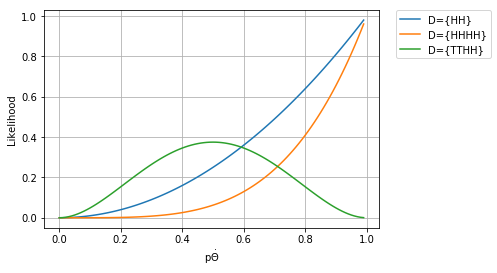

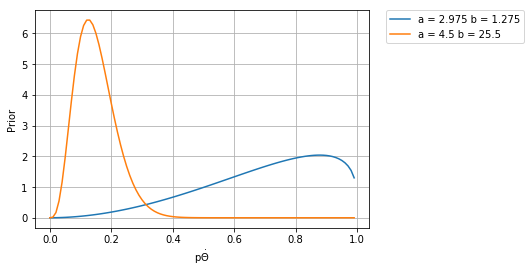

In [3]:
like_1 = likelihood(2, 2, range_number) # Calculate likelihood for D = {HH}
like_2 = likelihood(4, 4, range_number) # Calculate likelihood for D = {HHHH}
like_3 = likelihood(2, 4, range_number) # Calculate likelihood for D = {TTHH}

prior_1, mean_1, std_1 = prior(2.975, 1.275, range_number) # Calculate likelihood for D = {HH}
prior_2, mean_2, std_2 = prior(4.5, 25.5, range_number) # Calculate likelihood for D = {HHHH}
prior_3, mean_3, std_3 = prior(2, 4, range_number) # Calculate likelihood for D = {TTHH}

plot_graph(range_number, like_1, "D={HH}", like_2, "D={HHHH}", like_3, "D={TTHH}", r"p$\dot{\Theta}$", "Likelihood")

plot_graph(range_number, prior_1, "a = 2.975 b = 1.275", prior_2, "a = 4.5 b = 25.5", None, None, r"p$\dot{\Theta}$", "Prior")

Exercise 2
============

**Implement a method for posterior predictive distribution of a future observation.**
- appropriate calulation of posterior predictive
- write example demonstrating prediction

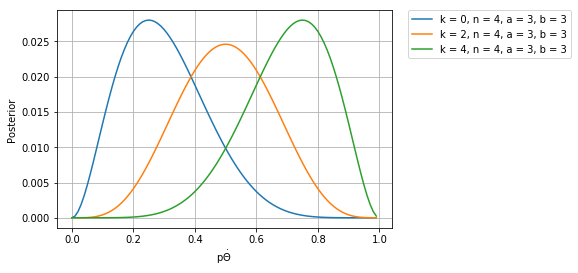

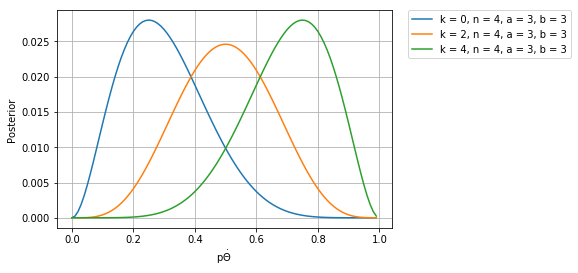

In [21]:
prior_1, likelihood_1, post_1 = beta_binom_density(0, 4, 3, 3, range_number)
prior_2, likelihood_2, post_2 = beta_binom_density(2, 4, 3, 3, range_number)
prior_3, likelihood_3, post_3 = beta_binom_density(4, 4, 3, 3, range_number)
plot_graph(range_number, 
           post_1, "k = 0, n = 4, a = 3, b = 3", 
           post_2, "k = 2, n = 4, a = 3, b = 3",
           post_3, "k = 4, n = 4, a = 3, b = 3",
           r"p$\dot{\Theta}$", "Posterior")

post_4 = beta_binom_density_2(0, 4, 3, 3, range_number)
post_5 = beta_binom_density_2(2, 4, 3, 3, range_number)
post_6 = beta_binom_density_2(4, 4, 3, 3, range_number)
plot_graph(range_number, 
           post_4, "k = 0, n = 4, a = 3, b = 3", 
           post_5, "k = 2, n = 4, a = 3, b = 3",
           post_6, "k = 4, n = 4, a = 3, b = 3",
           r"p$\dot{\Theta}$", "Posterior")

Exercise 3
==================

**Implement sequential way of updating posterior (online learning):**
- write apropriate methods using Beta distribution
- demonstrate on chart how posterior evolves with data stream (eg. one by one example)
- perform online learning experiment with two datasets from UCI data repository

Dataset and Class read functions
---------------

In [5]:
def import_dataset(input_dataset):
    data = pd.read_csv(input_dataset)   
    return data

def import_class(input_dataset):
    data = import_dataset(input_dataset)
    dataClass = data['class']
    dataClass = shuffle(dataClass)
    return dataClass

def count_class(df):
    positive= 0
    negative = 0
    
    for i in df:
        if i == 1:
            positive = positive + 1
        else:
            negative = negative + 1
    return positive, negative

Parameters
-------------

In [12]:
input_dataset_pima = "Datasets/pima-indians-diabetes/pima-indians-diabetes.csv"
input_dataset_tic_tac_toe = "Datasets/tic-tac-toe/tic-tac-toe-1-0.csv"
df = import_class(input_dataset_pima)
df_2 = import_class(input_dataset_tic_tac_toe)
df_2 = df_2[200:df_2.size-100]

n = df.size                   # or df.size
n_2 = df_2.size

a = 3                    # Beta model alpha parametr
b = 3                    # Beta model beta parametr
clearGraph = True       # Show history of plotting or not
interval = 100

Graph plotting functions
---------------

In [7]:
# Initialization function: plot the background of each frame
def init():
    line.set_data([], [])
    return (line,)

# Generator that yields items instead of returning a list
def randomGenerator(dataset, maxNumbers, a, b):
    i = 0
    positive= 0
    negative = 0
    while i < maxNumbers:
        if df.iloc[i] == 1:
            positive = positive + 1
        else:
            negative = negative + 1
        prior_1, likelihood_1, post_1 = beta_binom_density(positive, positive+negative, a, b, range_number)
        yield post_1
        i += 1

# Animation function which re-draw every frame
def animate(num, clearGraph, gen): 
    ax.set_ylim(( 0, 0.3))
    if clearGraph:
        ax.clear()
    
    x, y = plot_graph_for_animation(range_number, next(gen), r"p$\dot{\Theta}$", "Posterior")
    line.set_data(x, y)
    
    return line,

def plot_graph_for_animation(x, y = None, xLabel = None, yLabel = None):  
    plt.plot(x, y)
    plt.grid(True)
    plt.xlabel(xLabel)
    plt.ylabel(yLabel)
    ax.set_ylim(( 0, 0.3))
    
    return x, y

Plotting Code
------------

In [8]:
positive, negative = count_class(df[0:n])
print('Pima Indians Diabetes: positives: {0}, negatives: {1}'.format(positive, negative))
positive, negative = count_class(df_2[0:n_2])
print('Tic Tac Toe          : positives: {0}, negatives: {1}'.format(positive, negative))

Pima Indians Diabetes: positives: 268, negatives: 500
Tic Tac Toe          : positives: 428, negatives: 230


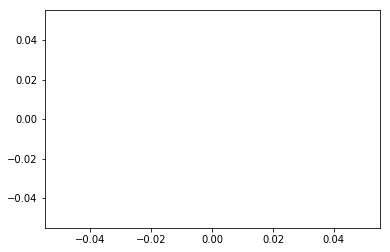

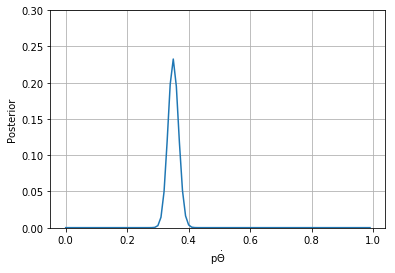

In [14]:
gen = randomGenerator(df, n, a, b)
ax = plt.gca()
line, = ax.plot([], [], lw=2)

fig, ax = plt.subplots()
animation =  anim.FuncAnimation(fig, animate, init_func=init, frames=n, interval=interval, fargs=(clearGraph, gen, ) )
HTML(animation.to_jshtml())    

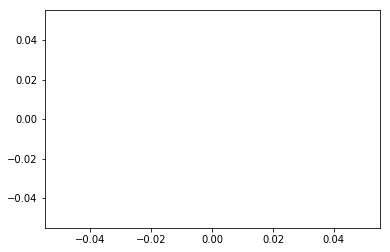

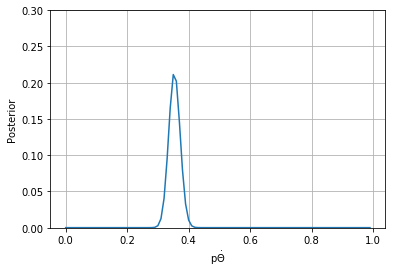

In [15]:
gen_2 = randomGenerator(df_2, n_2, a, b)
ax = plt.gca()
line, = ax.plot([], [], lw=2)

fig, ax = plt.subplots()
animation_2 =  anim.FuncAnimation(fig, animate, init_func=init, frames=n_2, interval=interval, fargs=(clearGraph, gen_2, ) )
HTML(animation_2.to_jshtml()) 